# Data-Driven Crop Diagnostic Platform for Farmers

## Project Overview

Our project aims to develop a data-driven AI platform that leverages image classification technology to diagnose crop diseases and provide comprehensive insights and actionable recommendations to rural farmers. By integrating image data with environmental factors, we strive to enhance agricultural productivity and promote sustainable farming practices.

## Objectives

- **Identify Crop Diseases**: Use image classification to accurately identify various crop diseases.
- **Predictive Model Development**: Develop a model that combines image data with environmental factors to provide comprehensive insights into crop health.
- **Actionable Recommendations**: Provide farmers with practical advice on managing and preventing crop diseases based on the model's predictions.
- **Time Series Analysis**: Investigate the use of time series analysis to predict the spread of crop diseases based on environmental factors.

## Our Solution

AI-Driven Crop Diagnostic Platform: A user-friendly mobile application where farmers can upload images of their crops. Our AI algorithms will analyze the images to diagnose issues such as pests, diseases, and nutrient deficiencies. The platform will also incorporate environmental data to provide a holistic view of crop health.

## Key Features:

- **Instant Diagnostics**: Real-time analysis of crop images with high accuracy.
- **Predictive Insights**: Combining image data with environmental factors for comprehensive health insights.
- **Actionable Recommendations**: Tailored advice on how to address identified issues and prevent future occurrences.
- **Support Network**: Access to community forums, real-time chat support, and local field agents for additional assistance.

# Data Sources Details

### PlantVillage Dataset
- **Source**: Kaggle, PlantVillage
- **Columns**:

**`image_id`**: Unique identifier for each image

**`image_path`**: Path to the image file

**`crop_type`**: Type of crop (e.g., apple, grape, tomato)

**`disease_type`**: Type of disease (e.g., apple scab, grape black rot)

**`health_status`**: Health status of the plant (healthy or diseased)

**`image`**: The image data itself

### NASA Earth Observing System Data and Information System (EOSDIS)

## Data Loading and Understanding
Load the images from both folders using a data generator and displays the names of all the classes and also images from the various classes.

In [1]:
# import libraries
import os
import glob
import matplotlib.pyplot as plt
from PIL import Image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import shutil
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras.layers import Input
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import EarlyStopping

Create a class **`DataLoadingAndUnderstanding`** to `load`, `manage` and `visualize image data` from directories for image classification tasks, specifically for datasets with and without augmentation.

Found 54300 images belonging to 38 classes.
Found 60339 images belonging to 38 classes.
Classes: ['Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Blueberry___healthy', 'Cherry___Powdery_mildew', 'Cherry___healthy', 'Corn___Cercospora_leaf_spot Gray_leaf_spot', 'Corn___Common_rust', 'Corn___Northern_Leaf_Blight', 'Corn___healthy', 'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy', 'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy', 'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spi

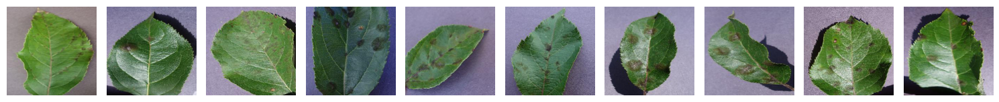

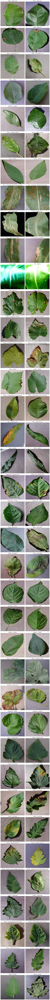

In [2]:
# Class DataLoadingAndUnderstanding
class DataLoadingAndUnderstanding:
    def __init__(self, no_aug_dir, aug_dir, target_size=(224, 224), batch_size=32):
        """
        Initialize with directories containing the dataset, and set up data generators.

        :param no_aug_dir: Directory for dataset without augmentation.
        :param aug_dir: Directory for dataset with augmentation.
        :param target_size: Tuple specifying the target size of the images.
        :param batch_size: Batch size for data generators.
        """
        self.no_aug_dir = no_aug_dir
        self.aug_dir = aug_dir
        self.target_size = target_size
        self.batch_size = batch_size
        
        # Initialize data generators
        self.no_aug_datagen = ImageDataGenerator(rescale=1./255)
        self.aug_datagen = ImageDataGenerator(rescale=1./255)
        
        # Load data
        self.no_aug_generator = self._load_data(self.no_aug_datagen, self.no_aug_dir)
        self.aug_generator = self._load_data(self.aug_datagen, self.aug_dir)
        
        # Get classes
        self.classes = self.no_aug_generator.class_indices.keys()

    def _load_data(self, datagen, directory):
        """
        Private method to load data from a directory using a given ImageDataGenerator.

        :param datagen: Instance of ImageDataGenerator.
        :param directory: Directory from which to load images.
        :return: A generator that yields batches of images from the specified directory.
        """
        return datagen.flow_from_directory(
            directory,
            target_size=self.target_size,
            batch_size=self.batch_size,
            class_mode='categorical'
        )
    
    def show_classes(self):
        """Display the list of classes (disease categories)."""
        print(f"Classes: {list(self.classes)}")
    
    def visualize_images_from_folder(self, folder_path, num_images=10):
        """
        Display a few images from a specified folder.

        :param folder_path: Path to the folder containing images.
        :param num_images: Number of images to display.
        """
        # Ensure the folder exists
        if not os.path.exists(folder_path):
            print(f"Folder does not exist: {folder_path}")
            return
        
        # List all image files in the folder
        image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
        
        # Check if there are images available
        if len(image_files) == 0:
            print(f"No images found in {folder_path}")
            return
        
        # Limit to the specified number of images
        image_files = image_files[:num_images]
        
        plt.figure(figsize=(15, 15))
        
        for i, image_file in enumerate(image_files):
            image_path = os.path.join(folder_path, image_file)
            try:
                img = Image.open(image_path)
                plt.subplot(1, num_images, i + 1)
                plt.imshow(img)
                plt.axis('off')
            except Exception as e:
                print(f"Could not open image {image_path}: {e}")
        
        plt.tight_layout()
        plt.show()
    
    def display_sample_images(self, samples_per_class=1, image_size=(224, 224)):
        """
        Display sample images from each class to get an understanding of the data.

        :param samples_per_class: Number of images to display per class.
        :param image_size: Size to resize the images for display (width, height).
        """
        num_classes = len(self.classes)
        fig, axes = plt.subplots(nrows=num_classes, ncols=samples_per_class, figsize=(5 * samples_per_class, 5 * num_classes))

        # Loop through each class and display sample images
        for i, cls in enumerate(self.classes):
            image_paths = glob.glob(os.path.join(self.no_aug_dir, cls, "*.JPG"))
            if len(image_paths) == 0:
                # If there are no images for this class, skip it and continue
                print(f"No images found for class: {cls}")
                continue

            for j in range(min(samples_per_class, len(image_paths))):  # Display only available images
                image_path = image_paths[j]  # Get the j-th image for the i-th class
                image = Image.open(image_path).resize(image_size)  # Resize image
                axes[i, j].imshow(image)
                axes[i, j].set_title(cls, fontsize=12)  # Set the title as the class name
                axes[i, j].axis('off')  # Hide axis

            # Hide unused subplots
            for k in range(len(image_paths), samples_per_class):
                axes[i, k].axis('off')

        plt.tight_layout()
        plt.show()

# Visualize image from specific folder
data_loader = DataLoadingAndUnderstanding(
    no_aug_dir='Plant_leave_diseases_dataset_without_augmentation',
    aug_dir='Plant_leave_diseases_dataset_with_augmentation'
)
data_loader.show_classes()
data_loader.visualize_images_from_folder('Plant_leave_diseases_dataset_without_augmentation/Apple___Apple_scab')
data_loader.display_sample_images(samples_per_class=2)


## 3. Data Cleaning

### ***3.1 Remove Corrupt Images***
Check for and remove any corrupt or unreadable images.

In [3]:
# Create function `check_corrupt_images`
def check_corrupt_images(directory):
    corrupt_images = []
    
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file.lower().endswith(('.jpg', '.jpeg', '.png')):
                file_path = os.path.join(root, file)
                try:
                    # Attempt to open the image and verify it
                    with Image.open(file_path) as img:
                        img.verify()  # Verify that it is not corrupt
                except (IOError, SyntaxError, OSError) as e:
                    print(f'Corrupt image detected and removed: {file_path}')
                    os.remove(file_path)  # Remove the corrupt image
                    corrupt_images.append(file_path)
    
    if not corrupt_images:
        return "No corrupt images found."
    else:
        return f"Total corrupt images found and removed: {len(corrupt_images)}"


This function identifies and removes corrupt image files from a specified directory.

In [4]:
# Specify the directories to the datasets
no_aug_dir='Plant_leave_diseases_dataset_without_augmentation'
aug_dir='Plant_leave_diseases_dataset_with_augmentation'

In [5]:
# Call the function to check  for corrupt images in the dataset without_augmentation
result = check_corrupt_images(no_aug_dir)
print(result)

No corrupt images found.


In [6]:
# Call the function to check  for corrupt images in the dataset with_augmentation
result = check_corrupt_images(aug_dir)
print(result)

No corrupt images found.


***There are no corrupt images in our dataset***

## 4. Exploratory Data Analysis (EDA)

### ***4.1 Univariate Analysis***

Create a function `plot_class_distribution` that analyzes and visualizes the distribution of images across different classes in the directory.


In [12]:
# Create a function plot_class_distribution
def plot_class_distribution(directory):
    class_counts = {}
    
    # Count the number of images per class
    for root, dirs, files in os.walk(directory):
        if len(files) > 0:
            class_name = os.path.basename(root)
            class_counts[class_name] = len(files)
    
    # Plotting for all classes
    plt.figure(figsize=(12, 8))
    plt.bar(class_counts.keys(), class_counts.values(), color='skyblue')
    
    plt.xlabel('Class')
    plt.ylabel('Number of Images')
    plt.title('Class Distribution (All Classes)')
    
    plt.xticks(rotation=45, ha='right')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()
    
    # Plotting for the top 5 classes
    top_5_classes = dict(sorted(class_counts.items(), key=lambda item: item[1], reverse=True)[:5])
    
    plt.figure(figsize=(8, 6))
    plt.bar(top_5_classes.keys(), top_5_classes.values(), color='orange')
    
    plt.xlabel('Class')
    plt.ylabel('Number of Images')
    plt.title('Top 5 Classes with Most Images')
    
    plt.xticks(rotation=45, ha='right')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

    # Plotting for the bottom 5 classes
    bottom_5_classes = dict(sorted(class_counts.items(), key=lambda item: item[1])[:5])
    
    plt.figure(figsize=(8, 6))
    plt.bar(bottom_5_classes.keys(), bottom_5_classes.values(), color='green')
    
    plt.xlabel('Class')
    plt.ylabel('Number of Images')
    plt.title('Bottom 5 Classes with Fewest Images')
    
    plt.xticks(rotation=45, ha='right')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()


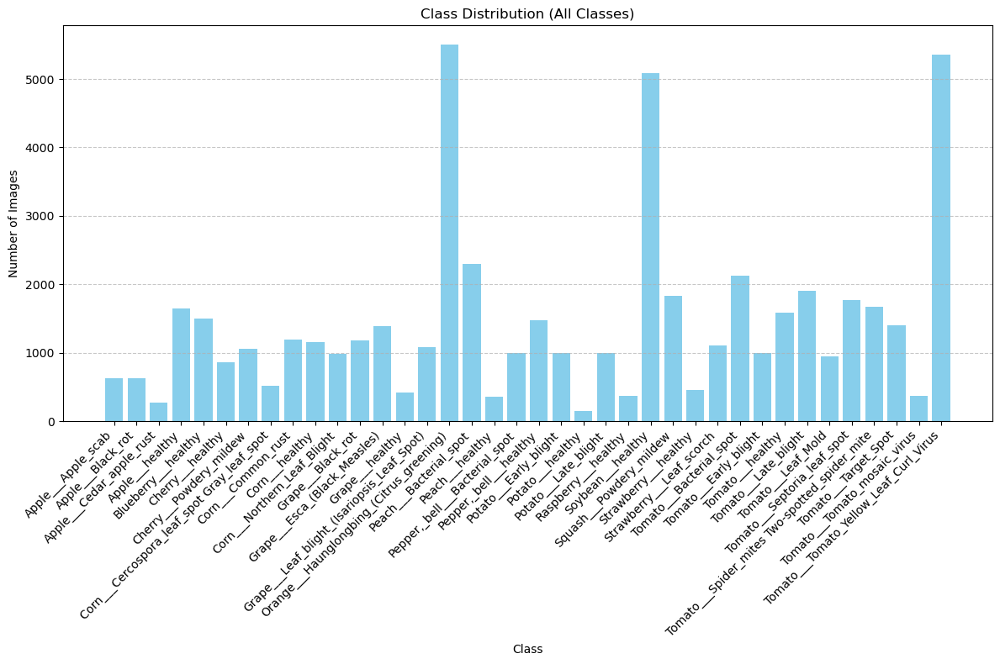

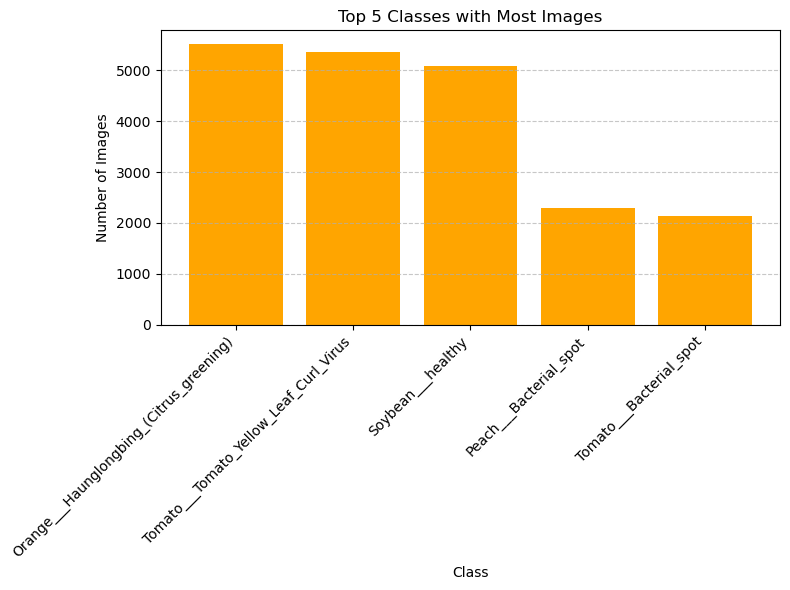

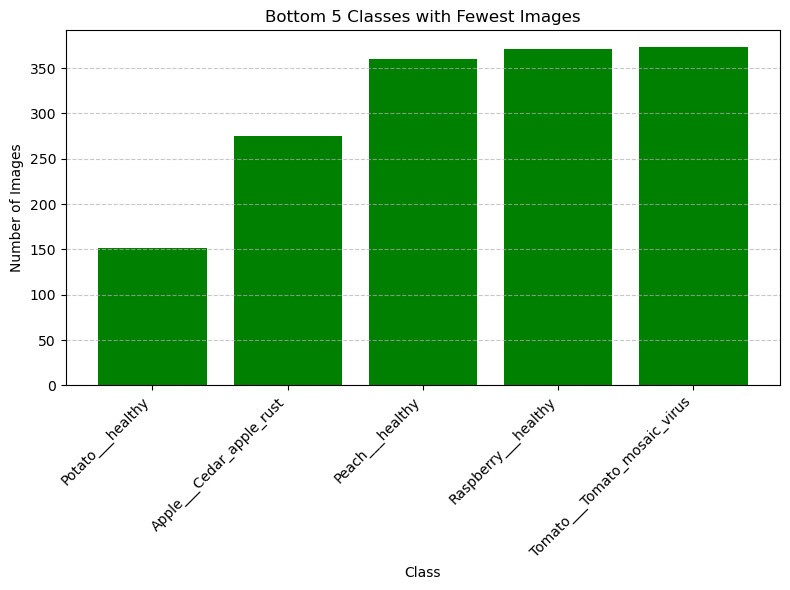

In [13]:
plot_class_distribution(no_aug_dir)

### Observation

- The dataset exhibits a significant class imbalance, with certain classes containing considerably more samples than others.
- Orange___Haunglongbing_(Citrus_greening) has the highest number of images, while several classes have a relatively small number of samples.
- The distribution is skewed towards specific classes, which can impact model performance.
- Classes with fewer samples might be underrepresented, leading to potential biases during training.


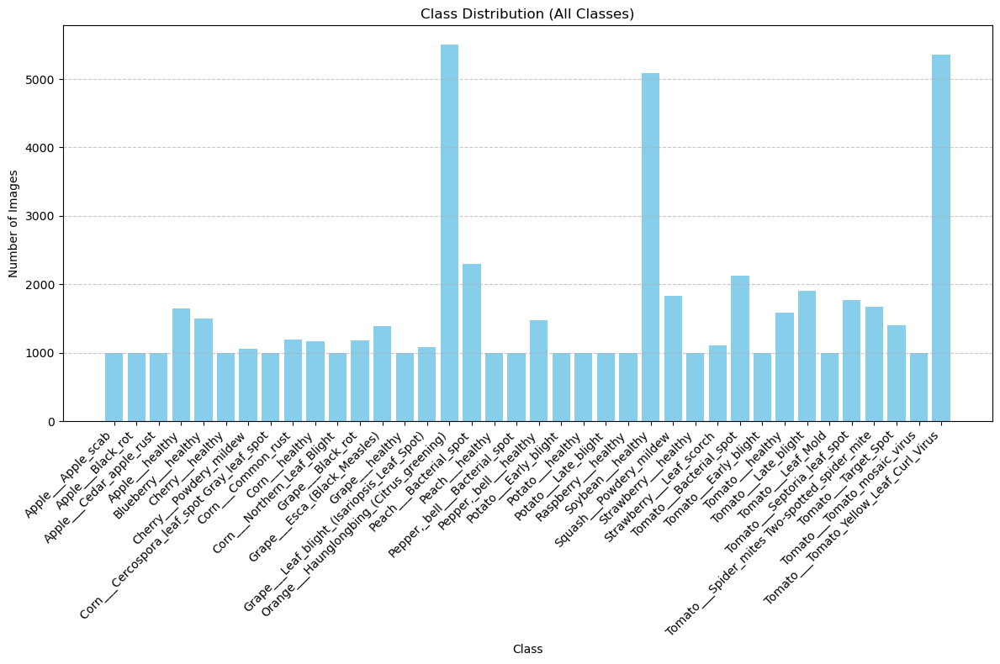

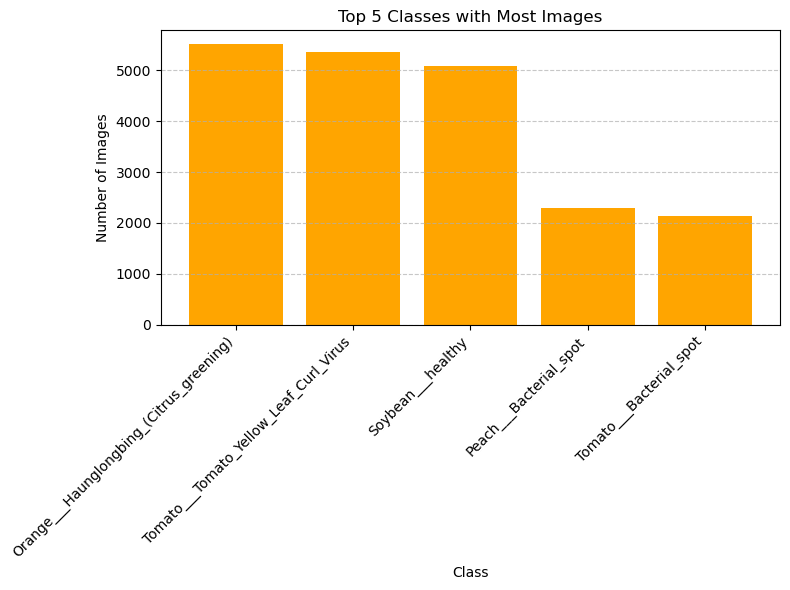

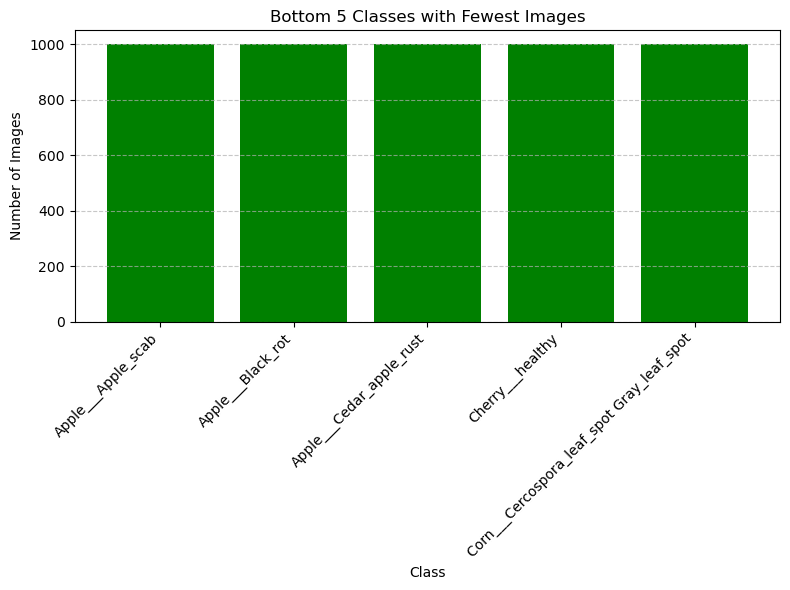

In [14]:
plot_class_distribution(aug_dir)

### Observation

- The overall number of images has significantly increased compared to the no_aug_dir plot.
- Most classes now have a reasonable number of samples, potentially leading to improved model performance.
- Orange___Haunglongbing_(Citrus_greening), Soybean___healthy and Tomato_Yellow_Leaf_Curl_Virus classes have a higher number of samples compared to other classes.

# Data Preparation

Create a `DataPreparation` class to prepare image data for training the machine learning model. 

In [15]:
# Create class DataPreparation
class DataPreparation:
    def __init__(self, data_dir, target_size=(224, 224), batch_size=32, test_split=0.1, validation_split=0.2):
        """
        Initialize with dataset directory and parameters for image processing.
        
        :param data_dir: Directory where the dataset is stored.
        :param target_size: Target size for resizing images.
        :param batch_size: Batch size for training and validation.
        :param test_split: Proportion of data to reserve for testing.
        :param validation_split: Proportion of data to reserve for validation.
        """
        self.data_dir = data_dir
        self.target_size = target_size
        self.batch_size = batch_size
        self.test_split = test_split
        self.validation_split = validation_split
        self.label_encoder = LabelEncoder()  # Initialize label encoder

    def encode_labels(self, classes):
        """
        Encode the class labels into numerical format.
        
        :param classes: List of class names.
        :return: Dictionary mapping class names to numerical labels.
        """
        labels = self.label_encoder.fit_transform(classes)
        label_mapping = dict(zip(self.label_encoder.classes_, labels))
        print(f"Label Mapping: {label_mapping}")
        return label_mapping
    
    def split_data(self):
        """
        Split the dataset into training, validation, and test sets.
        """
        # Ensure base directories exist
        if not os.path.exists(self.data_dir):
            raise FileNotFoundError(f"Data directory {self.data_dir} not found")

        split_dirs = ['train', 'validation', 'test']
        for split_dir in split_dirs:
            split_path = os.path.join(self.data_dir, split_dir)
            if not os.path.exists(split_path):
                os.makedirs(split_path, exist_ok=True)
            for cls in os.listdir(self.data_dir):
                cls_path = os.path.join(self.data_dir, cls)
                if os.path.isdir(cls_path):
                    os.makedirs(os.path.join(split_path, cls), exist_ok=True)

        all_images = []
        all_labels = []
        for cls in os.listdir(self.data_dir):
            cls_path = os.path.join(self.data_dir, cls)
            if os.path.isdir(cls_path):
                for file in os.listdir(cls_path):
                    if file.lower().endswith(('.jpg', '.jpeg', '.png')):
                        all_images.append(os.path.join(cls_path, file))
                        all_labels.append(cls)

        # Encode labels
        label_mapping = self.encode_labels(np.unique(all_labels))

        # Split the data
        X_train, X_temp, y_train, y_temp = train_test_split(all_images, all_labels, test_size=self.test_split, stratify=all_labels)
        X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=self.test_split / (1 - self.test_split), stratify=y_temp)

        # Copy files to respective directories
        for image, label in zip(X_train, y_train):
            shutil.copy2(image, os.path.join(self.data_dir, 'train', label, os.path.basename(image)))
        for image, label in zip(X_val, y_val):
            shutil.copy2(image, os.path.join(self.data_dir, 'validation', label, os.path.basename(image)))
        for image, label in zip(X_test, y_test):
            shutil.copy2(image, os.path.join(self.data_dir, 'test', label, os.path.basename(image)))

    def load_data(self):
        """
        Load the data using ImageDataGenerator and create training, validation, and test sets.
        
        :return: Training, validation, and test data generators.
        """
        datagen = ImageDataGenerator(rescale=1./255, validation_split=self.validation_split)  # Rescale images and split into training/validation sets
        
        # Create training data generator
        train_generator = datagen.flow_from_directory(
            os.path.join(self.data_dir, 'train'),
            target_size=self.target_size,
            batch_size=self.batch_size,
            class_mode='categorical',
            shuffle=True  # Shuffle training data
        )
        
        # Create validation data generator
        validation_generator = datagen.flow_from_directory(
            os.path.join(self.data_dir, 'validation'),
            target_size=self.target_size,
            batch_size=self.batch_size,
            class_mode='categorical'
        )
        
        # Create test data generator
        test_datagen = ImageDataGenerator(rescale=1./255)  # Only rescale for test data
        test_generator = test_datagen.flow_from_directory(
            os.path.join(self.data_dir, 'test'),
            target_size=self.target_size,
            batch_size=self.batch_size,
            class_mode='categorical'
        )
        
        return train_generator, validation_generator, test_generator


In [16]:
# Initialize data preparation
# Update with the actual path
data_dir = 'Plant_leave_diseases_dataset_without_augmentation'  \

data_preparation = DataPreparation(data_dir)

# Split the data into train, validation, and test
data_preparation.split_data()   

Label Mapping: {'Apple___Apple_scab': 0, 'Apple___Black_rot': 1, 'Apple___Cedar_apple_rust': 2, 'Apple___healthy': 3, 'Blueberry___healthy': 4, 'Cherry___Powdery_mildew': 5, 'Cherry___healthy': 6, 'Corn___Cercospora_leaf_spot Gray_leaf_spot': 7, 'Corn___Common_rust': 8, 'Corn___Northern_Leaf_Blight': 9, 'Corn___healthy': 10, 'Grape___Black_rot': 11, 'Grape___Esca_(Black_Measles)': 12, 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 13, 'Grape___healthy': 14, 'Orange___Haunglongbing_(Citrus_greening)': 15, 'Peach___Bacterial_spot': 16, 'Peach___healthy': 17, 'Pepper,_bell___Bacterial_spot': 18, 'Pepper,_bell___healthy': 19, 'Potato___Early_blight': 20, 'Potato___Late_blight': 21, 'Potato___healthy': 22, 'Raspberry___healthy': 23, 'Soybean___healthy': 24, 'Squash___Powdery_mildew': 25, 'Strawberry___Leaf_scorch': 26, 'Strawberry___healthy': 27, 'Tomato___Bacterial_spot': 28, 'Tomato___Early_blight': 29, 'Tomato___Late_blight': 30, 'Tomato___Leaf_Mold': 31, 'Tomato___Septoria_leaf_spot': 32

In [18]:
# Load training, validation, and test data
train_gen, val_gen, test_gen = data_preparation.load_data()

Found 48870 images belonging to 38 classes.
Found 4826 images belonging to 38 classes.
Found 604 images belonging to 38 classes.


In [19]:
def get_classes_from_directory(directory):
    """
    Get a list of class names from the directory structure.
    
    :param directory: Directory containing the class subdirectories.
    :return: Set of class names.
    """
    return set(os.listdir(directory))

def check_classes(train_dir, val_dir, test_dir):
    """
    Check if the classes are the same across training, validation, and test datasets.
    
    :param train_dir: Directory containing training data.
    :param val_dir: Directory containing validation data.
    :param test_dir: Directory containing test data.
    """
    # Get classes from each directory
    train_classes = get_classes_from_directory(train_dir)
    val_classes = get_classes_from_directory(val_dir)
    test_classes = get_classes_from_directory(test_dir)
    
    # Print class names
    print(f"Classes in training data: {train_classes}")
    print(f"Classes in validation data: {val_classes}")
    print(f"Classes in test data: {test_classes}")
    
    # Check if all class sets are the same
    if train_classes == val_classes == test_classes:
        print("All datasets have the same classes.")
    else:
        print("Classes are not consistent across datasets.")
        
        # Find the missing classes
        all_classes = train_classes.union(val_classes).union(test_classes)
        print("All classes found:", all_classes)
        print("Classes missing in some datasets:")
        print("In training but not in validation or test:", all_classes - train_classes)
        print("In validation but not in training or test:", all_classes - val_classes)
        print("In test but not in training or validation:", all_classes - test_classes)

# Set your directories
train_dir = 'Plant_leave_diseases_dataset_without_augmentation/train'
val_dir = 'Plant_leave_diseases_dataset_without_augmentation/validation'
test_dir = 'Plant_leave_diseases_dataset_without_augmentation/test'

# Check classes
check_classes(train_dir, val_dir, test_dir)


Classes in training data: {'Pepper,_bell___healthy', 'Tomato___Target_Spot', 'Cherry___healthy', 'Corn___healthy', 'Apple___Cedar_apple_rust', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Tomato___Leaf_Mold', 'Strawberry___Leaf_scorch', 'Apple___healthy', 'Tomato___Early_blight', 'Apple___Black_rot', 'Apple___Apple_scab', 'Corn___Northern_Leaf_Blight', 'Potato___healthy', 'Soybean___healthy', 'Tomato___healthy', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Grape___Black_rot', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Pepper,_bell___Bacterial_spot', 'Tomato___Late_blight', 'Potato___Late_blight', 'Squash___Powdery_mildew', 'Blueberry___healthy', 'Grape___Esca_(Black_Measles)', 'Corn___Common_rust', 'Tomato___Bacterial_spot', 'Peach___Bacterial_spot', 'Tomato___Tomato_mosaic_virus', 'Cherry___Powdery_mildew', 'Potato___Early_blight', 'Grape___healthy', 'Peach___healthy', 'Orange___Haunglongbing_(Citrus_greening)', 'Strawberry___healthy', 'Raspberry___healthy', 'Corn___Cercospora_

# MODELLING

## BASELINE MODEL

Create a class **BaseModel** to `create`, `train` and `evaluate` a Convolutional Neural Network (CNN) for image classification tasks.

In [20]:
# Create class BaseModel
class BaseModel:
    def __init__(self, input_shape, num_classes):
        """
        Initialize the model with input shape and number of classes.
        
        :param input_shape: Shape of the input images.
        :param num_classes: Number of output classes.
        """
        self.input_shape = input_shape
        self.num_classes = num_classes
        self.model = self.build_model()  
    
    # Build the model with default parameters
    def build_model(self, 
                    conv_layers=None, 
                    dense_layers=None, 
                    dropout_rate=0.5, 
                    optimizer=Adam()):
        """
        Build the CNN model architecture.
        
        :param conv_layers: List of tuples, where each tuple represents (filters, kernel_size) for a Conv2D layer.
                            Default is [(32, (3, 3)), (64, (3, 3))].
        :param dense_layers: List of integers where each represents the number of units in a Dense layer.
                             Default is [128].
        :param dropout_rate: Dropout rate for the Dropout layers. Default is 0.5.
        :param optimizer: Optimizer to compile the model. Default is Adam.
        
        :return: Compiled model.
        """
        # Default parameters if none provided
        if conv_layers is None:
            conv_layers = [(32, (3, 3)), (64, (3, 3))]
        if dense_layers is None:
            dense_layers = [128]
        
        model = Sequential()

        # Add convolutional layers
        for i, (filters, kernel_size) in enumerate(conv_layers):
            if i == 0:
                model.add(Conv2D(filters, kernel_size, activation='relu', input_shape=self.input_shape))
            else:
                model.add(Conv2D(filters, kernel_size, activation='relu'))
            model.add(MaxPooling2D((2, 2)))

        # Flatten the output
        model.add(Flatten())

        # Add dense layers
        for units in dense_layers:
            model.add(Dense(units, activation='relu'))
            model.add(Dropout(dropout_rate))

        # Output layer
        model.add(Dense(self.num_classes, activation='softmax'))

        # Compile the model
        model.compile(optimizer=optimizer, 
                      loss='categorical_crossentropy', 
                      metrics=['accuracy'])
        
        return model

    def summary(self):
        """Print the summary of the model."""
        self.model.summary()

    def train(self, train_generator, validation_generator, epochs=10):
        """
        Train the model using the provided training and validation data generators.
        
        :param train_generator: Training data generator.
        :param validation_generator: Validation data generator.
        :param epochs: Number of epochs to train the model. Default is 10.
        
        :return: Training history object.
        """
        history = self.model.fit(
            train_generator,
            epochs=epochs,
            validation_data=validation_generator
        )
        return history

    def evaluate(self, test_generator):
        """
        Evaluate the model on the test data.
        
        :param test_generator: Test data generator.
        :return: Test loss and accuracy.
        """
        test_loss, test_accuracy = self.model.evaluate(test_generator)
        print(f"Test Accuracy: {test_accuracy * 100:.2f}%")
        return test_loss, test_accuracy


In [21]:
# Define input shape and number of classes
input_shape = (224, 224, 3)  # Example input shape
num_classes = 38  # Replace with the actual number of classes

# Initialize and build the model
model_builder = BaseModel(input_shape, num_classes)

 # Print model summary
model_builder.summary() 


D:\Anaconda\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 186624)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │    23,888,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 38)             │         4,902 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 23,912,294 (91.22 MB)

 Trainable params: 23,912,294 (91.22 MB)

 Non-trainable params: 0 (0.00 B)

### Observation
**Conv2D Layers:** 
- These layers detect features in the images. 
- The first one has 32 filters, and the second has 64 filters.

**MaxPooling2D Layers:** 
- These layers reduce the size of the feature maps, making the model more efficient.

**Flatten Layer:**
- This layer flattens the 3D output from the convolutional layers into a 1D array, preparing it for the dense layers.

**Dense Layers:** 
- These fully connected layers make the final predictions. The first dense layer has 128 neurons, and the last one outputs 38 classes.

**Dropout Layer:** 
- Prevent overfitting by randomly setting some of the neurons to zero during training.

**`model_builder` has about `23,912,294` parameters and is designed to process and classify images into 38 categories.**

In [23]:
# NB: If Model already saved skip to load model file
# Train the model
history = model_builder.train(train_gen, val_gen, epochs=5)

# Evaluate the model
test_loss, test_accuracy = model_builder.evaluate(test_gen)

Epoch 1/5
1528/1528 ━━━━━━━━━━━━━━━━━━━━ 1324s 866ms/step - accuracy: 0.6709 - loss: 1.0701 - val_accuracy: 0.8224 - val_loss: 0.6098
Epoch 2/5
1528/1528 ━━━━━━━━━━━━━━━━━━━━ 1353s 885ms/step - accuracy: 0.7305 - loss: 0.8436 - val_accuracy: 0.8359 - val_loss: 0.5468
Epoch 3/5
1528/1528 ━━━━━━━━━━━━━━━━━━━━ 1436s 940ms/step - accuracy: 0.7713 - loss: 0.6975 - val_accuracy: 0.8697 - val_loss: 0.4275
Epoch 4/5
1528/1528 ━━━━━━━━━━━━━━━━━━━━ 1375s 899ms/step - accuracy: 0.8174 - loss: 0.5656 - val_accuracy: 0.8690 - val_loss: 0.4321
Epoch 5/5
1528/1528 ━━━━━━━━━━━━━━━━━━━━ 1387s 907ms/step - accuracy: 0.8340 - loss: 0.4932 - val_accuracy: 0.8690 - val_loss: 0.4460
19/19 ━━━━━━━━━━━━━━━━━━━━ 5s 273ms/step - accuracy: 0.8681 - loss: 0.4114
Test Accuracy: 88.25%


### Evaluating and Saving Model Performance Results**

In [24]:
# Save the model in keras format
model_builder.model.save('base_model.keras')

In [25]:
# Load the model file
loaded_model = load_model('base_model.keras')

# Test data generator called test_gen
test_loss, test_accuracy = loaded_model.evaluate(test_gen)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

19/19 ━━━━━━━━━━━━━━━━━━━━ 4s 147ms/step - accuracy: 0.8973 - loss: 0.3113
Test Accuracy: 88.25%


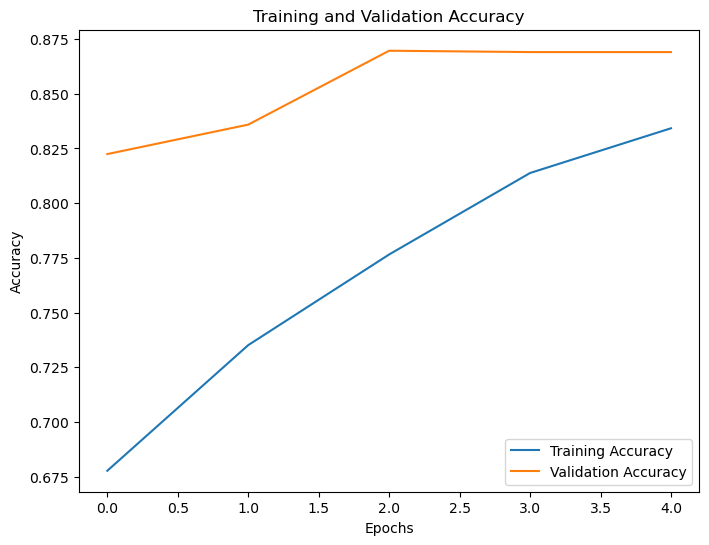

In [26]:
import matplotlib.pyplot as plt

# Assuming `history` is the object returned by `model_builder.train()`
# Extracting accuracy and validation accuracy from the history object
train_accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']

# Extracting the number of epochs
epochs_range = range(len(train_accuracy))

# Plotting the graph
plt.figure(figsize=(8, 6))
plt.plot(epochs_range, train_accuracy, label='Training Accuracy')
plt.plot(epochs_range, val_accuracy, label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend(loc='lower right')
plt.show()


## CLASS IMBALANCE

- Next is to deal with class imbalance in the base model to get more accurate results.
- Also introducing early stopping

In [ ]:
# Add callbacks and class_weight to the BaseModel
class BaseModel:
    def __init__(self, input_shape, num_classes):
        """
        Initialize the model with input shape and number of classes.
        
        :param input_shape: Shape of the input images.
        :param num_classes: Number of output classes.
        """
        self.input_shape = input_shape
        self.num_classes = num_classes
        self.model = self.build_model()  # Build the model with default parameters

    def build_model(self, 
                    conv_layers=None, 
                    dense_layers=None, 
                    dropout_rate=0.5, 
                    optimizer=Adam()):
        """
        Build the CNN model architecture.
        
        :param conv_layers: List of tuples, where each tuple represents (filters, kernel_size) for a Conv2D layer.
                            Default is [(32, (3, 3)), (64, (3, 3))].
        :param dense_layers: List of integers where each represents the number of units in a Dense layer.
                             Default is [128].
        :param dropout_rate: Dropout rate for the Dropout layers. Default is 0.5.
        :param optimizer: Optimizer to compile the model. Default is Adam.
        
        :return: Compiled model.
        """
        # Default parameters if none provided
        if conv_layers is None:
            conv_layers = [(32, (3, 3)), (64, (3, 3))]
        if dense_layers is None:
            dense_layers = [128]
        
        model = Sequential()

        # Add convolutional layers
        for i, (filters, kernel_size) in enumerate(conv_layers):
            if i == 0:
                model.add(Conv2D(filters, kernel_size, activation='relu', input_shape=self.input_shape))
            else:
                model.add(Conv2D(filters, kernel_size, activation='relu'))
            model.add(MaxPooling2D((2, 2)))

        # Flatten the output
        model.add(Flatten())

        # Add dense layers
        for units in dense_layers:
            model.add(Dense(units, activation='relu'))
            model.add(Dropout(dropout_rate))

        # Output layer
        model.add(Dense(self.num_classes, activation='softmax'))

        # Compile the model
        model.compile(optimizer=optimizer, 
                      loss='categorical_crossentropy', 
                      metrics=['accuracy'])
        
        return model

    def summary(self):
        """Print the summary of the model."""
        self.model.summary()

    def train(self, train_generator, validation_generator, epochs=10, callbacks=None, class_weight=None):
        """
        Train the model using the provided training and validation data generators.

        :param train_generator: Training data generator.
        :param validation_generator: Validation data generator.
        :param epochs: Number of epochs to train the model. Default is 10.
        :param callbacks: List of callbacks to pass to the fit method.
        :param class_weight: Dictionary mapping class indices to a weight for the class.

        :return: Training history object.
        """
        history = self.model.fit(
            train_generator,
            epochs=epochs,
            validation_data=validation_generator,
            
            # Add callbacks also
            callbacks=callbacks,
            
            # Add class_weight to the fit method
            class_weight=class_weight  
        )
        return history

    def evaluate(self, test_generator):
        """
        Evaluate the model on the test data.
        
        :param test_generator: Test data generator.
        :return: Test loss and accuracy.
        """
        test_loss, test_accuracy = self.model.evaluate(test_generator)
        print(f"Test Accuracy: {test_accuracy * 100:.2f}%")
        return test_loss, test_accuracy

In [ ]:
# Assuming you have the classes and their labels in the training set
y_train = train_gen.classes  # Get the labels from the data generator

# Compute class weights
class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)

# Convert the class weights to a dictionary
class_weights = {i: class_weights[i] for i in range(len(class_weights))}

In [ ]:
# Set up EarlyStopping
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=3,
    restore_best_weights=True
)

In [ ]:
# Train the model with class weights
history = model_builder.model.fit(
    train_gen,
    epochs=5,
    validation_data=val_gen,
    callbacks=[early_stopping],
    class_weight=class_weights
)

In [ ]:
# Save the model
model_builder.model.save('class_imbalance.keras')

In [ ]:
# Load the model file
loaded_model = load_model('class_imbalance.keras')

# test data generator called test_gen
test_loss, test_accuracy = loaded_model.evaluate(test_gen)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

# Save the model in HDF5 format
loaded_model.save('class_imbalance.h5')

In [ ]:
# Plot training & validation accuracy values
plt.figure(figsize=(14, 5))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.show()

### Observation
**Accuracy and Loss Improvement:**
- Model's accuracy on the training data starts at 25.89% in the first epoch and improves to 93.36% by the 10th epoch. 
- Significant learning and improvement in the model's performance on the training set.

**Validation Performance:**
- Validation accuracy improves from 76.80% in the first epoch to 99.51% by the 10th epoch. 
- Model will generalize well to unseen data, which is a good sign of effective learning.

**Validation Loss:**
- Validation loss decreases from 0.826 to 0.0189 over the epochs, indicating that the model's predictions on the validation set become more accurate and less uncertain.

**Training Loss:** 
- Training loss decreases from 2.92 to 0.196 over the epochs. 
- Indicates that the model is learning to fit the training data better as it progresses.

## General View
The model shows exceptional learning performance, with high accuracy and very low loss on both training and validation datasets. 
Model is effectively capturing patterns in the data and generalizing well.

## DATA AUGMENTATION

Next is to use data augmentation to artificially expand the size and diversity of the dataset by applying various transformations.

Create a function `get_augmented_data_generators` that sets up data generators to streamline the process of loading and processing image data during model training and evaluation.

In [ ]:
# Define a function to create data generators for training, validation, and testing.
def get_augmented_data_generators(data_dir, target_size=(224, 224), batch_size=32):
    """
    Create data generators with augmentation for training and without augmentation for validation and testing.
    
    :param data_dir: Directory containing the data.
    :param target_size: Size to which each image will be resized.
    :param batch_size: Number of images to return in each batch.
    
    :return: Training, validation, and test data generators with and without augmentation.
    """
    # Create data generators with augmentation for training
    train_datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest'
    )
    
    # Create training data generator
    train_generator = train_datagen.flow_from_directory(
        os.path.join(data_dir, 'train'),
        target_size=target_size,
        batch_size=batch_size,
        class_mode='categorical'
    )
    
    # Create validation and test data generators without augmentation
    val_datagen = ImageDataGenerator(rescale=1./255)
    
    validation_generator = val_datagen.flow_from_directory(
        os.path.join(data_dir, 'validation'),
        target_size=target_size,
        batch_size=batch_size,
        class_mode='categorical'
    )
    
    test_generator = val_datagen.flow_from_directory(
        os.path.join(data_dir, 'test'),
        target_size=target_size,
        batch_size=batch_size,
        class_mode='categorical'
    )
    
    return train_generator, validation_generator, test_generator


In [ ]:
# Setup data augmentation
train_aug_gen, val_gen, test_gen = get_augmented_data_generators(data_dir)

In [ ]:
# Create class BaseModel
class BaseModel:
    def __init__(self, input_shape, num_classes):
        """
        Initialize the model with input shape and number of classes.
        
        :param input_shape: Shape of the input images.
        :param num_classes: Number of output classes.
        """
        self.input_shape = input_shape
        self.num_classes = num_classes
        self.model = self.build_model()  # Build the model with default parameters

    def build_model(self, 
                    conv_layers=None, 
                    dense_layers=None, 
                    dropout_rate=0.5, 
                    optimizer=Adam()):
        """
        Build the CNN model architecture.
        
        :param conv_layers: List of tuples, where each tuple represents (filters, kernel_size) for a Conv2D layer.
                            Default is [(32, (3, 3)), (64, (3, 3))].
        :param dense_layers: List of integers where each represents the number of units in a Dense layer.
                             Default is [128].
        :param dropout_rate: Dropout rate for the Dropout layers. Default is 0.5.
        :param optimizer: Optimizer to compile the model. Default is Adam.
        
        :return: Compiled model.
        """
        # Default parameters if none provided
        if conv_layers is None:
            conv_layers = [(32, (3, 3)), (64, (3, 3))]
        if dense_layers is None:
            dense_layers = [128]
        
        model = Sequential()
        
        # Add the Input layer
        model.add(Input(shape=self.input_shape))

        # Add convolutional layers
        for filters, kernel_size in conv_layers:
            model.add(Conv2D(filters, kernel_size, activation='relu'))
            model.add(MaxPooling2D((2, 2)))

        # Flatten the output
        model.add(Flatten())

        # Add dense layers
        for units in dense_layers:
            model.add(Dense(units, activation='relu'))
            model.add(Dropout(dropout_rate))

        # Output layer
        model.add(Dense(self.num_classes, activation='softmax'))

        # Compile the model
        model.compile(optimizer=optimizer, 
                      loss='categorical_crossentropy', 
                      metrics=['accuracy'])
        
        return model

    def summary(self):
        """Print the summary of the model."""
        self.model.summary()

    def train(self, train_generator, validation_generator, epochs=10, class_weights=None):
        """
        Train the model using the provided training and validation data generators.
        
        :param train_generator: Training data generator.
        :param validation_generator: Validation data generator.
        :param epochs: Number of epochs to train the model. Default is 10.
        :param class_weights: Optional dictionary of class weights to handle class imbalance.
        
        :return: Training history object.
        """
        history = self.model.fit(
            train_generator,
            epochs=epochs,
            validation_data=validation_generator,
            class_weight=class_weights
        )
        return history

    def evaluate(self, test_generator):
        """
        Evaluate the model on the test data.
        
        :param test_generator: Test data generator.
        :return: Test loss and accuracy.
        """
        test_loss, test_accuracy = self.model.evaluate(test_generator)
        print(f"Test Accuracy: {test_accuracy * 100:.2f}%")
        return test_loss, test_accuracy

Next, initialize an instance of the **BaseModel** class.

In [ ]:
# Initialize model
model_with_augmentation = BaseModel(input_shape, num_classes)

Finally train the prepared data.

In [ ]:
# Train the model with augmented data
history_augmentation = model_with_augmentation.train(train_aug_gen, val_gen, epochs=10)

In [ ]:
# Access the Keras model and save it
model_with_augmentation.model.save('model_with_augmentation.keras')

In [ ]:
# Load the saved model
loaded_model = load_model('model_with_augmentation.keras')

# test data generator called test_gen
test_loss, test_accuracy = loaded_model.evaluate(test_gen)
print(f"Test Accuracy: {test_accuracy * 100:.2f}%")

In [ ]:
import matplotlib.pyplot as plt

# Extract data from the training history
epochs = range(1, 11) 
train_acc = history_augmentation.history['accuracy']
val_acc = history_augmentation.history['val_accuracy']
train_loss = history_augmentation.history['loss']
val_loss = history_augmentation.history['val_loss']

# Create subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Plot accuracy
ax1.plot(epochs, train_acc, 'bo-', label='Training Accuracy')
ax1.plot(epochs, val_acc, 'ro-', label='Validation Accuracy')
ax1.set_title('Training and Validation Accuracy')
ax1.set_xlabel('Epochs')
ax1.set_ylabel('Accuracy')
ax1.legend()
ax1.grid(True)

# Plot loss
ax2.plot(epochs, train_loss, 'bo-', label='Training Loss')
ax2.plot(epochs, val_loss, 'ro-', label='Validation Loss')
ax2.set_title('Training and Validation Loss')
ax2.set_xlabel('Epochs')
ax2.set_ylabel('Loss')
ax2.legend()
ax2.grid(True)

# Show plots
plt.tight_layout()
plt.show()

### Observation

- Both training and validation accuracy show consistent improvement, indicating that the model is learning and generalizing well over time. 
- Validation accuracy is close to training accuracy, suggesting good model performance.
- The training and validation loss are decreasing, meaning the model is effectively minimizing error during training and validating on unseen data.
- The gap between training and validation loss is minimal, showing that the model is not overfitting.

### Recommendation
- Use the `Class Imbalance Model`(**Test Accuracy: 99.61%**), as it shows consistent performance across multiple metrics and test sets. 
- The higher accuracy suggests it might handle class imbalances effectively.